# Exploratory Data Analysis and Feature Engineering for Supervised ML

## Data Preparation

Generating a MapInfo File with hexagons and their stats.

Use the custom geometry which splits the hexagons along city borders
and subsequently merges small and medium (PCCLASS 2,3) cities into single 
areas. (Which is a file output from elsewhere, technically could be computed
here as well). 

It combines the above against tiles from the Ookla dataset. This 
is done by calculating the spatial join (GeoPandas sjoin()) on the 
default "intersection" predicate. This allows some tiles 
to contribute to multiple hexagons if they partially overlap more 
than one area.

For many (rural) areas there are no or few tiles from this; so an expanding 
selection is done to try and get better stats in these areas by 
verifying the sum of tests in the area are at least 10, 
adding first the remainder of the "fixed" data tiles for 
earlier quarter, then all tiles tiles (including mobile tiles)
if that still does not give at least 10 tests. 

In [ ]:
import sys
sys.path.append("..")

%load_ext autoreload
%autoreload 1
%aimport src.datasets.joins
%aimport src.datasets.loading.statcan

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
from src.datasets.loading import statcan
from src.datasets.loading import ookla
from src.datasets import overlays

import statsmodels as sm
# import statsmodels.stats.weightstats
from scipy.stats import lognorm

import src.config
from pathlib import Path
import geopandas as gp
import src.datasets.joins as joins

import re

In [ ]:
# Defining output directory
output_name = "AllQuartersOrBestEstimate_On_DissolvedSmallerCitiesHexes"
output_dir = src.config.DATA_DIRECTORY / "processed" / "statistical_geometries"
output_dir.mkdir(exist_ok=True)

In [ ]:
CRS = 'EPSG:4326'

### Load Stats Canada Data

In [ ]:
popctrs = statcan.boundary('population_centres')

In [ ]:
derived_geometry = (Path(src.config.DATA_DIRECTORY) / 'processed' / 'geometries').resolve()

speed_data = gp.read_file(derived_geometry / 'hexagons_w_dissolved_smaller_popctrs.geojson')#, driver='GeoJSON')
speed_data = speed_data.dropna(subset=['HEXUID_PCPUID'])

In [ ]:
speed_data.head()

In [ ]:
speed_data.columns

### Load Ookla Data

In [ ]:
tiles = ookla.canada_speed_tiles()
tiles = tiles.to_crs(CRS)

In [ ]:
unique_tiles = tiles[['quadkey','geometry']].drop_duplicates()
unique_tiles = unique_tiles.sjoin(speed_data[['HEXUID_PCPUID','geometry']].to_crs(tiles.crs))
unique_tiles = unique_tiles.drop(['index_right'],axis=1)

In [ ]:
tiles = tiles.merge(unique_tiles.drop(['geometry'],axis=1), on='quadkey')

In [ ]:
tiles.head()

In [ ]:
tiles.columns

### Selecting all quarters and removing areas with less than 10 test values

In [ ]:
tests_in_all_quarters = tiles.loc[lambda s:(s.year==2023) | ( (s.year==2019) & (s.quarter==1) )].loc[lambda s:s.conn_type=='fixed'].groupby('HEXUID_PCPUID')['tests'].sum()
tests_in_all_quarters

In [ ]:
level_1_areas = tests_in_all_quarters.index[tests_in_all_quarters > 10].dropna()
level_1_areas

In [ ]:
fixed_tests_counts_nolevel1 = tiles.loc[lambda s:~s.HEXUID_PCPUID.isin(level_1_areas)].loc[lambda s:s.conn_type == 'fixed'].groupby('HEXUID_PCPUID')['tests'].sum()
fixed_tests_counts_nolevel1

In [ ]:
level_2_areas = fixed_tests_counts_nolevel1.index[fixed_tests_counts_nolevel1 > 10].dropna()
level_2_areas

In [ ]:
level_3_areas = tiles.drop_duplicates(subset='HEXUID_PCPUID').loc[lambda s:~s.HEXUID_PCPUID.isin(level_1_areas) & ~s.HEXUID_PCPUID.isin(level_2_areas)].HEXUID_PCPUID.dropna().values
level_3_areas

In [ ]:
l1_tiles = tiles.loc[lambda s:s.HEXUID_PCPUID.isin(level_1_areas)].loc[lambda s:s.conn_type=='fixed']
l2_tiles = tiles.loc[lambda s:s.HEXUID_PCPUID.isin(level_2_areas)].loc[lambda s:s.conn_type=='fixed']
l3_tiles = tiles.loc[lambda s:s.HEXUID_PCPUID.isin(level_3_areas)]

selected_tiles = pd.concat([l1_tiles, l2_tiles, l3_tiles]).drop_duplicates(subset=['quadkey','conn_type','year','quarter'])
selected_tiles

### Merging the datasets and calculating relevant stats

In [ ]:
speed_data = joins.add_simple_stats(speed_data, selected_tiles, 'HEXUID_PCPUID')

In [ ]:
speed_data = joins.add_50_10_stats(speed_data, selected_tiles, 'HEXUID_PCPUID')

In [ ]:
unused_columns = ['pc_area','hex_area','pc_frac', 'hex_frac']
for col in unused_columns:
    del speed_data[col]

speed_data['ookla_50_10_percentile'] = speed_data.apply(lambda s:min(s['50_down_percentile'], s['10_up_percentile']), axis=1)

In [ ]:
speed_data = joins.add_tile_info(speed_data, selected_tiles, "HEXUID_PCPUID")

In [ ]:
def year_serializeable(tuple_or_na):
    if pd.isna(tuple_or_na):
        return "No Data"
    return "Q{1} {0}".format(*tuple_or_na)

def connections_serializeable(set_):
    if set_ == {'fixed'}:
        return 'fixed'
    elif set_ == {'fixed','mobile'}:
        return 'fixed and mobile'
    elif set_ == {'mobile'}:
        return 'mobile'
    else:
        return 'No Data'


pat = '(\d\d)p_*'
t = '25p_d_kbps'
fix_bad_names = lambda x: re.sub(pat, lambda s:f'P{s.group(1)}_', x)

In [ ]:
speed_data['min_year'] = speed_data['min_year'].apply(year_serializeable)
speed_data['max_year'] = speed_data['max_year'].apply(year_serializeable)
speed_data['connections'] = speed_data['connections'].apply(connections_serializeable)

speed_data.rename(columns=fix_bad_names, inplace=True)
speed_data.rename(columns={'50_down_percentile':'Down_50_percentile', '10_up_percentile':'Up_10_percentile'}, inplace=True)

In [ ]:
speed_data.rename(columns=fix_bad_names, inplace=True)
speed_data.rename(columns={'50_down_percentile':'Down_50_percentile', '10_up_percentile':'Up_10_percentile'}, inplace=True)

### Saving the created geoFrame

In [ ]:
speed_data.head()

In [ ]:
speed_data.columns

In [ ]:
speed_data.crs

In [ ]:
speed_data.loc[lambda s:(s.Pop2016 > 0.0) | (s.tests > 0.0)].to_file(output_dir / output_name, driver="MapInfo File")

In [ ]:
speed_data.loc[lambda s:(s.Pop2016 > 0.0) | (s.tests > 0.0)].to_file(output_dir / (output_name+".gpkg"), driver="GPKG")

## Exploratory Data Analysis

In [1]:
import src.config

# data analysis and visualization 
import numpy as np
import pandas as pd
import geopandas as gp
import seaborn as sns
import matplotlib.pyplot as plt 

# modeling packages
import statsmodels as sm
from sklearn import preprocessing, pipeline, compose
from sklearn import linear_model, model_selection, svm
from sklearn import metrics

In [2]:
# customize dataframe view
pd.set_option('display.max_columns', None)

In [3]:
# define data directory
data_name = "AllQuartersOrBestEstimate_On_DissolvedSmallerCitiesHexes"
data_dir = src.config.DATA_DIRECTORY / "processed" / "statistical_geometries"

In [4]:
# load data without regenerating the geodataframe 
data = gp.read_file(data_dir / (data_name+".gpkg"), driver="GPKG")

In [5]:
data.head()

,PCPUID,HEXUID_PCPUID,PRCODE,PCNAME,PCCLASS,Pop2016,TDwell2016_TLog2016,URDwell2016_RH2016,PHH_Count,Common_Type,Pop2016_at_50_10_Combined,TDwell2016_at_50_10_Combined,URDwell_at_50_10_Combined,Pop_Avail_50_10,TDwell_Avail_50_10,URDwell_Avail_50_10,avg_d_kbps,std_d_kbps,min_d_kbps,P25_d_kbps,P50_d_kbps,P75_d_kbps,max_d_kbps,avg_u_kbps,std_u_kbps,min_u_kbps,P25_u_kbps,P50_u_kbps,P75_u_kbps,max_u_kbps,avg_lat_ms,tests,ave_tests_per_tile,unique_devices,ave_devices_per_tile,num_tiles,Down_50_percentile,Up_10_percentile,ookla_50_10_percentile,min_year,max_year,connections,geometry
0,100792,NL47580528-100792,NL,St. John's,4,0.0,0.0,0.0,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,158449.144284,93758.541595,161.0,87303.0,154330.0,215499.0,587624.0,85493.039956,93758.541595,62.0,44604.0,77913.0,113657.00,418553.0,13.361820,15340.0,17.025527,5255.0,5.832408,901.0,87.125416,94.339623,87.125416,Q1 2019,Q1 2023,fixed,"MULTIPOLYGON (((-52.78788 47.56551, -52.78288 ..."
1,100792,NL47580529-100792,NL,St. John's,4,0.0,0.0,0.0,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,189884.916300,129507.236557,1398.0,86781.0,166928.0,263618.0,855354.0,101254.361233,129507.236557,48.0,29054.0,85596.0,140592.00,633774.0,16.612335,4537.0,6.662261,1355.0,1.989721,681.0,88.839941,94.860499,88.839941,Q1 2019,Q1 2023,fixed,"POLYGON ((-52.90996 47.56425, -52.90990 47.564..."
2,100792,NL47430528-100792,NL,St. John's,4,0.0,0.0,0.0,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,183984.000000,74691.885068,37021.0,140307.0,204667.0,243947.0,267312.0,98761.117647,74691.885068,15747.0,81501.0,83960.0,126825.00,179309.0,8.764706,256.0,15.058824,78.0,4.588235,17.0,94.117647,100.000000,94.117647,Q1 2019,Q1 2023,fixed,"POLYGON ((-52.76428 47.45587, -52.76436 47.454..."
3,100792,NL47510528-100792,NL,St. John's,4,0.0,0.0,0.0,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,169838.995219,96006.770122,54.0,101439.5,157905.0,224729.0,559988.0,88459.522541,96006.770122,93.0,45928.5,76834.5,115428.75,570790.0,14.470628,26328.0,17.983607,7761.0,5.301230,1464.0,90.983607,97.540984,90.983607,Q1 2019,Q1 2023,fixed,"POLYGON ((-52.79738 47.49030, -52.79781 47.490..."
4,100792,NL47510529-100792,NL,St. John's,4,0.0,0.0,0.0,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,189661.043774,118972.951803,221.0,98931.5,170575.0,262450.0,668781.0,99826.766537,118972.951803,489.0,40720.0,85566.0,133060.50,698768.0,14.540856,10810.0,10.515564,2871.0,2.792802,1028.0,90.466926,97.859922,90.466926,Q1 2019,Q1 2023,fixed,"POLYGON ((-52.91007 47.51346, -52.91014 47.513..."


### Looking for trends, patterns, etc.

#### Distribution analyses

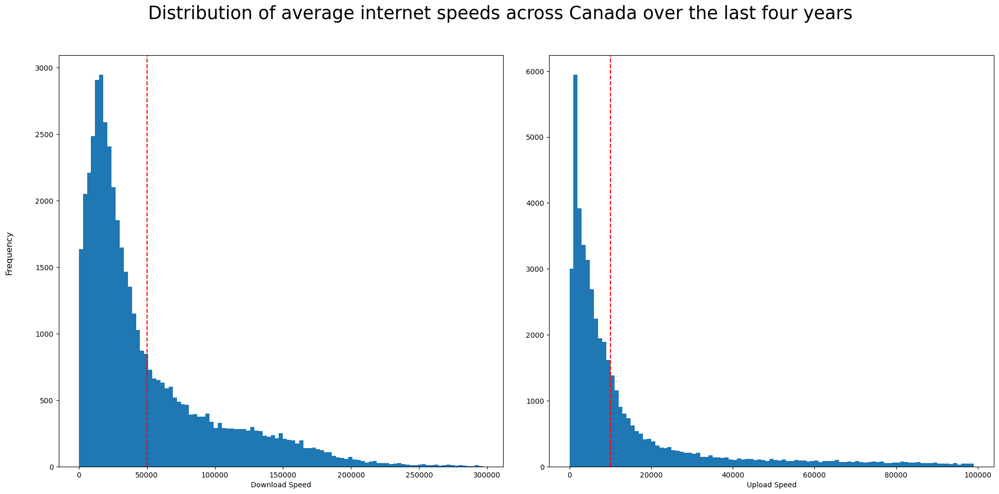

In [6]:
fig, axs = plt.subplots(1, 2, figsize=(20,10))

data.hist('avg_d_kbps', bins=range(0,300000,3000), ax=axs[0], grid=False)
data.hist('avg_u_kbps', bins=range(0,100000,1000), ax=axs[1], grid=False)

axs[0].axvline(50000, color='r', ls='--')
axs[1].axvline(10000, color='r', ls='--')

axs[0].set_xlabel('Download Speed')
axs[1].set_xlabel('Upload Speed')

axs[0].set_title('')
axs[1].set_title('')

fig.supylabel('Frequency')
fig.suptitle('Distribution of average internet speeds across ' \
             'Canada over the last four years',
             fontsize=25)
fig.tight_layout(pad=3);

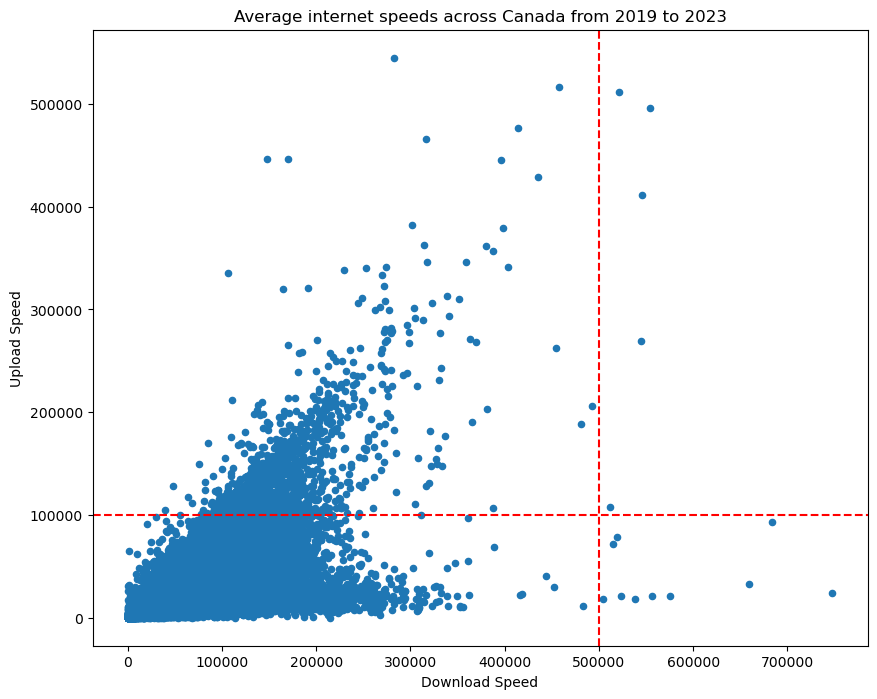

In [7]:
data.plot(x='avg_d_kbps', 
          y='avg_u_kbps',
          kind='scatter', 
          figsize=(10,8),
          grid=False,
          xlabel='Download Speed',
          ylabel='Upload Speed')
plt.gca().axvline(500000,color='r', ls='--')
plt.gca().axhline(100000,color='r', ls='--')
plt.title('Average internet speeds across Canada from 2019 to 2023');

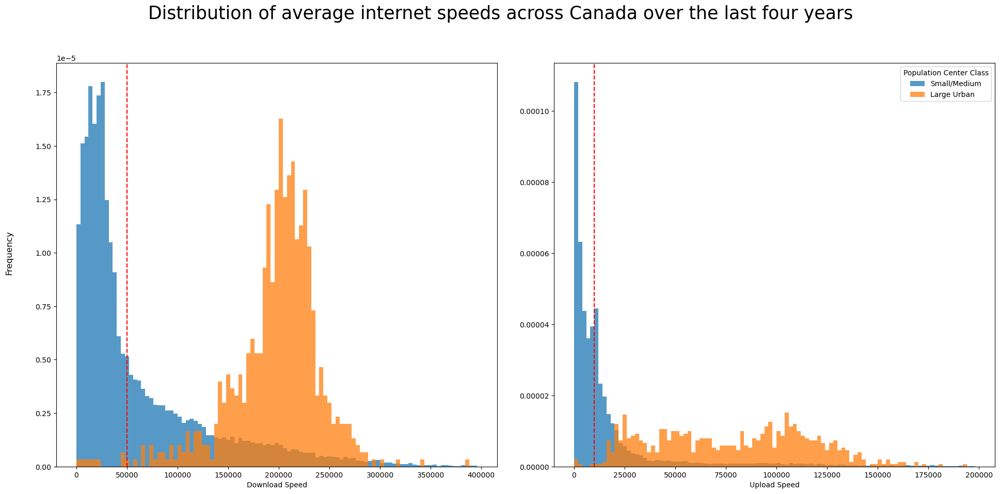

In [8]:
fig, axs = plt.subplots(1, 2, figsize=(20,10))

data.loc[lambda s:~(s.PCCLASS == '4')]['P75_d_kbps'].plot.hist(bins=range(0,400000,4000), 
                                                               density=True, alpha=0.75,
                                                               ax=axs[0], grid=False,
                                                               label='Small/Medium')
data.loc[lambda s:(s.PCCLASS == '4')]['P75_d_kbps'].plot.hist(bins=range(0,400000,4000), 
                                                              density=True,alpha=0.75,
                                                              ax=axs[0], grid=False,
                                                               label='Large Urban')


data.loc[lambda s:~(s.PCCLASS == '4')]['P75_u_kbps'].plot.hist(bins=range(0,200000,2000), 
                                                               density=True, alpha=0.75,
                                                               ax=axs[1], grid=False,
                                                               label='Small/Medium')
data.loc[lambda s:(s.PCCLASS == '4')]['P75_u_kbps'].plot.hist(bins=range(0,200000,2000), 
                                                              density=True,alpha=0.75,
                                                              ax=axs[1], grid=False,
                                                               label='Large Urban')

axs[0].axvline(50000, color='r', ls='--')
axs[1].axvline(10000, color='r', ls='--')

axs[0].set_xlabel('Download Speed')
axs[1].set_xlabel('Upload Speed')
axs[0].set_ylabel('')
axs[1].set_ylabel('')

axs[0].set_title('')
axs[1].set_title('')

fig.supylabel('Frequency')
fig.suptitle('Distribution of average internet speeds across ' \
             'Canada over the last four years',
             fontsize=25)
fig.tight_layout(pad=3)
plt.legend(title='Population Center Class');

#### Internet speeds and connection type

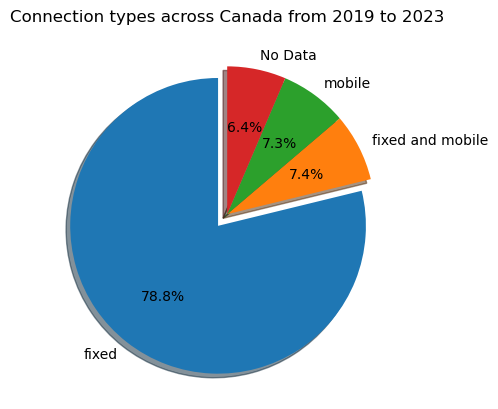

In [9]:
data['connections'].value_counts().plot(kind='pie', 
                                        autopct='%1.1f%%',
                                        explode=(0.1, 0, 0, 0),
                                        shadow=True, 
                                        startangle=90,
                                        ylabel='')
plt.title('Connection types across Canada from 2019 to 2023');

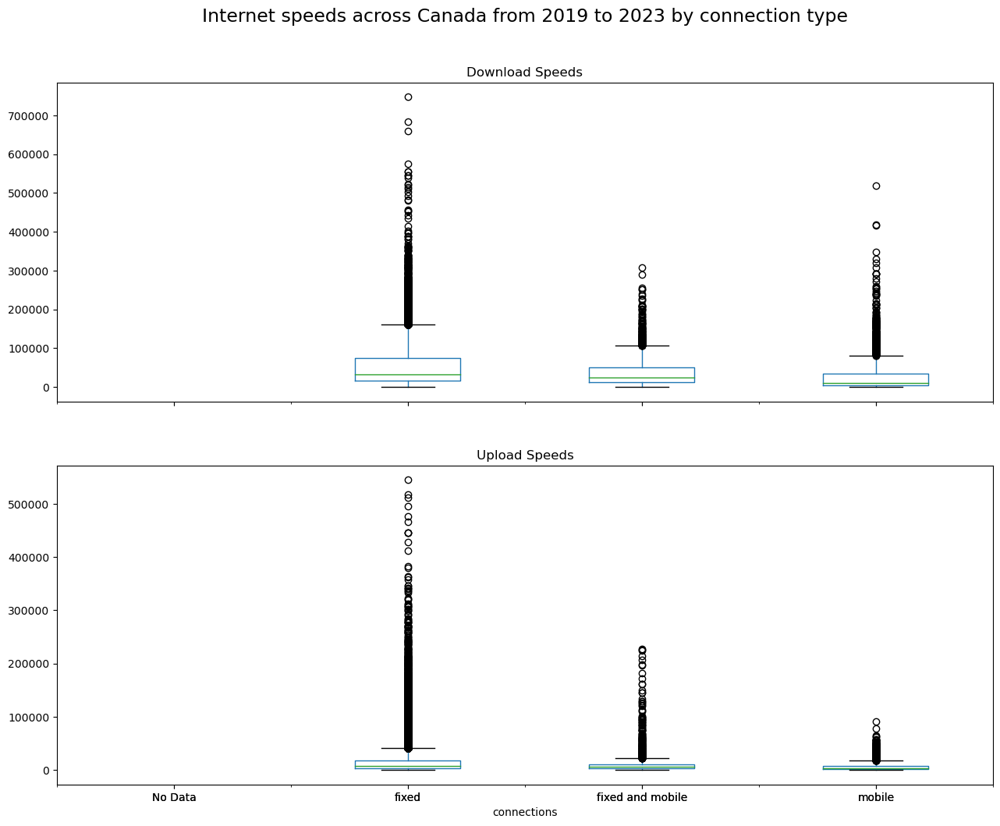

In [10]:
ax = data.boxplot(column=['avg_d_kbps', 'avg_u_kbps'], 
                  by='connections',
                  grid=False, 
                  figsize=(15,12),
                  layout=(2,1),
                  sharey=False)

ax[0].set_title('Download Speeds')
ax[1].set_title('Upload Speeds')

plt.suptitle('Internet speeds across Canada from ' \
             '2019 to 2023 by connection type',
             fontsize=17);

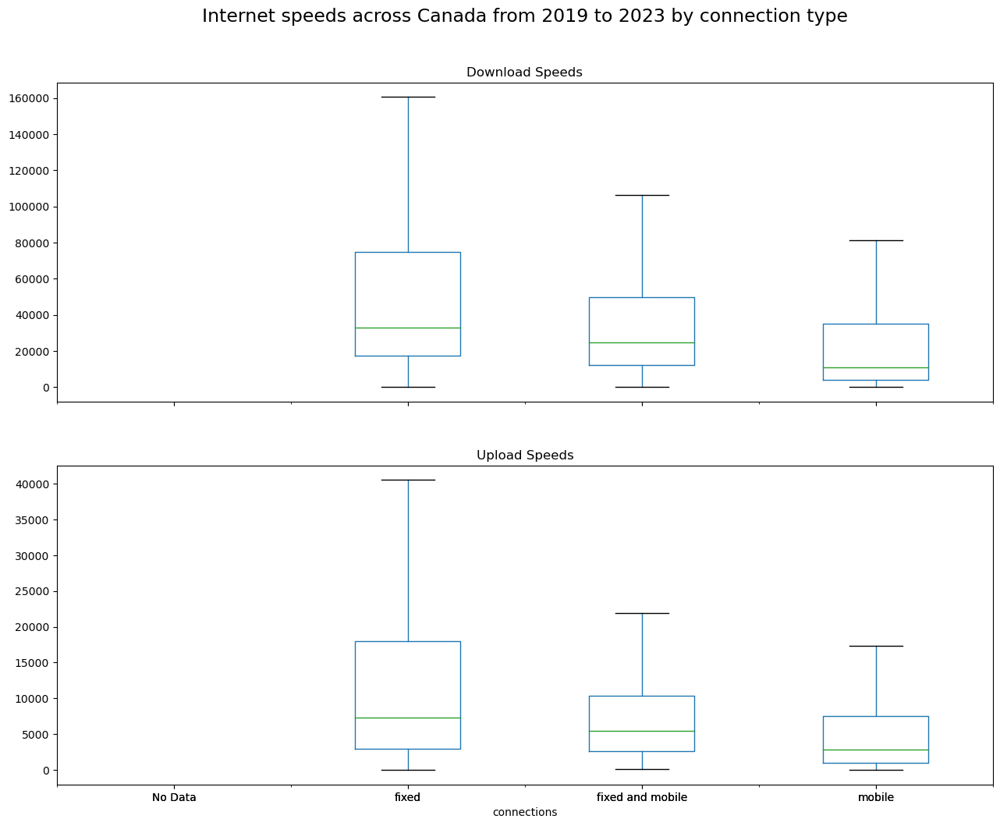

In [11]:
ax = data.boxplot(column=['avg_d_kbps', 'avg_u_kbps'], 
                  by='connections',
                  grid=False, 
                  figsize=(15,12),
                  layout=(2,1),
                  showfliers=False,
                  sharey=False)

ax[0].set_title('Download Speeds')
ax[1].set_title('Upload Speeds')

plt.suptitle('Internet speeds across Canada from ' \
             '2019 to 2023 by connection type',
             fontsize=17);

#### Reported vs. actual speeds in Alberta

In [12]:
# visualizing statscan vs. ookla for Alberta 
data.loc[lambda s:s.PRCODE == "AB"].loc[lambda s:s.Pop2016>0].explore(
    'ookla_50_10_percentile',scheme='equalinterval', k = 4, 
    tooltip=['HEXUID_PCPUID','PCNAME','Pop2016','Pop_Avail_50_10','ookla_50_10_percentile'],
    popup=[
        'HEXUID_PCPUID','PCNAME',
        'min_d_kbps','avg_d_kbps','max_d_kbps',
        'min_u_kbps','avg_u_kbps','max_u_kbps',
        'Pop2016','tests','num_tiles','unique_devices', 'min_year','max_year','connections',
        'Pop_Avail_50_10','ookla_50_10_percentile','Down_50_percentile','Up_10_percentile']
    )

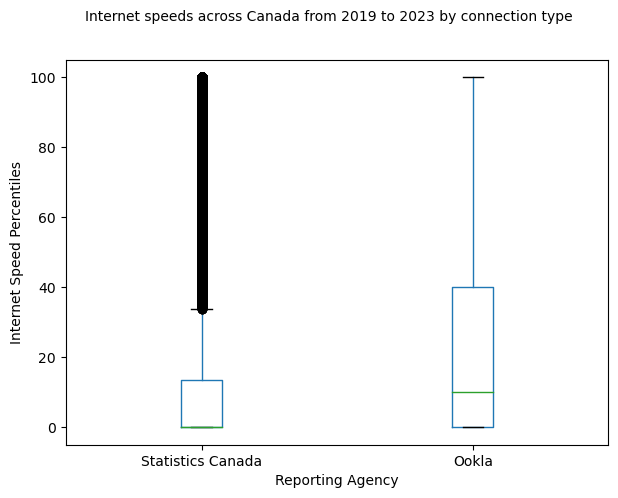

In [13]:
ax = data.boxplot(column=['Pop_Avail_50_10', 
                     'ookla_50_10_percentile'], 
                  grid=False, 
                  figsize=(7,5))
labels = ['Statistics Canada', 'Ookla']

ax.set_xlabel('Reporting Agency')
ax.set_ylabel('Internet Speed Percentiles')
ax.set_xticklabels(labels)


plt.suptitle('Internet speeds across Canada from ' \
             '2019 to 2023 by connection type',
             fontsize=10);

#### Testing and internet speeds

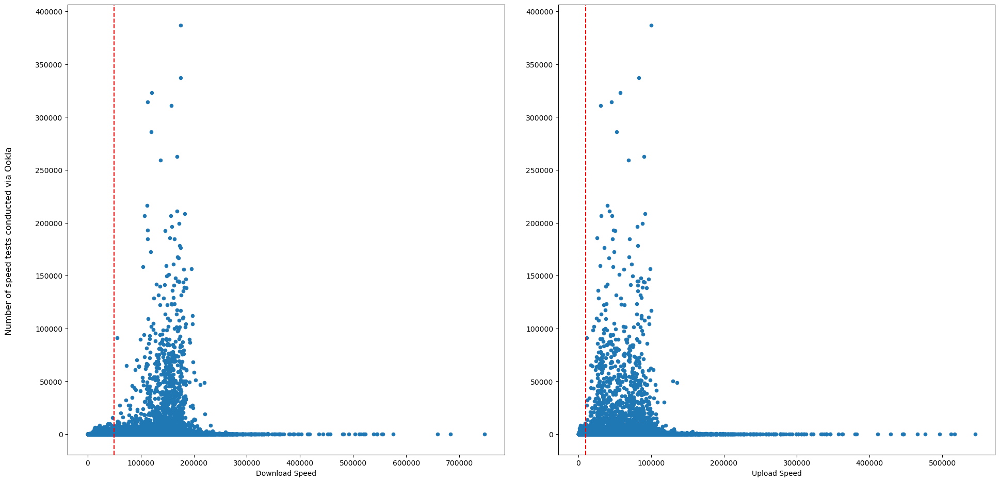

In [14]:
fig, axs = plt.subplots(1, 2, figsize=(20,10))

data.plot.scatter('avg_d_kbps', 'tests', ax=axs[0])
data.plot.scatter('avg_u_kbps', 'tests', ax=axs[1])

axs[0].axvline(50000, color='r', ls='--')
axs[1].axvline(10000, color='r', ls='--')

axs[0].set_xlabel('Download Speed')
axs[1].set_xlabel('Upload Speed')
axs[0].set_ylabel('')
axs[1].set_ylabel('')

fig.supylabel('Number of speed tests conducted via Ookla')
#fig.suptitle('Distribution of average internet speeds across ' \
#             'Canada over the last four years',
#             fontsize=25)
fig.tight_layout(pad=3);

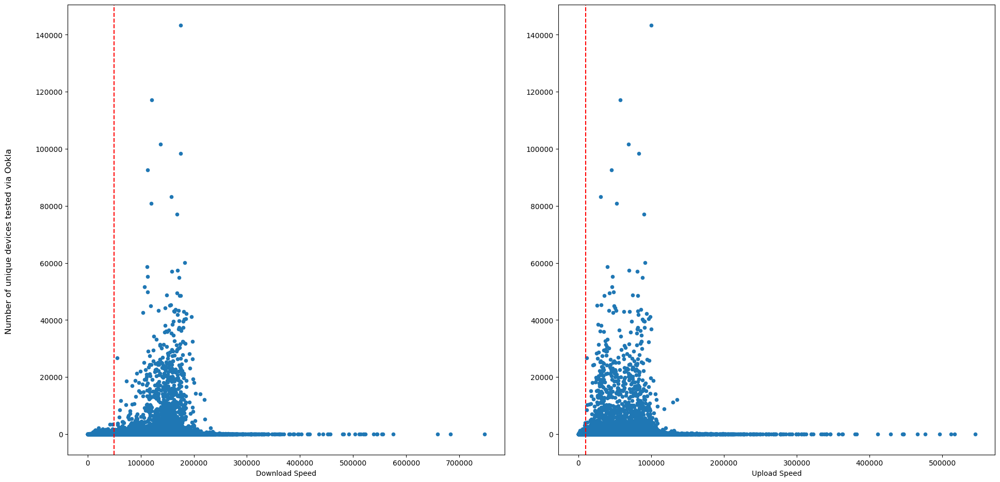

In [15]:
fig, axs = plt.subplots(1, 2, figsize=(20,10))

data.plot.scatter('avg_d_kbps', 'unique_devices', ax=axs[0])
data.plot.scatter('avg_u_kbps', 'unique_devices', ax=axs[1])

axs[0].axvline(50000, color='r', ls='--')
axs[1].axvline(10000, color='r', ls='--')

axs[0].set_xlabel('Download Speed')
axs[1].set_xlabel('Upload Speed')
axs[0].set_ylabel('')
axs[1].set_ylabel('')

fig.supylabel('Number of unique devices tested via Ookla')
#fig.suptitle('Distribution of average internet speeds across ' \
#             'Canada over the last four years',
#             fontsize=25)
fig.tight_layout(pad=3);

In [16]:
data['test_frequency'] = data['tests']/data['unique_devices']

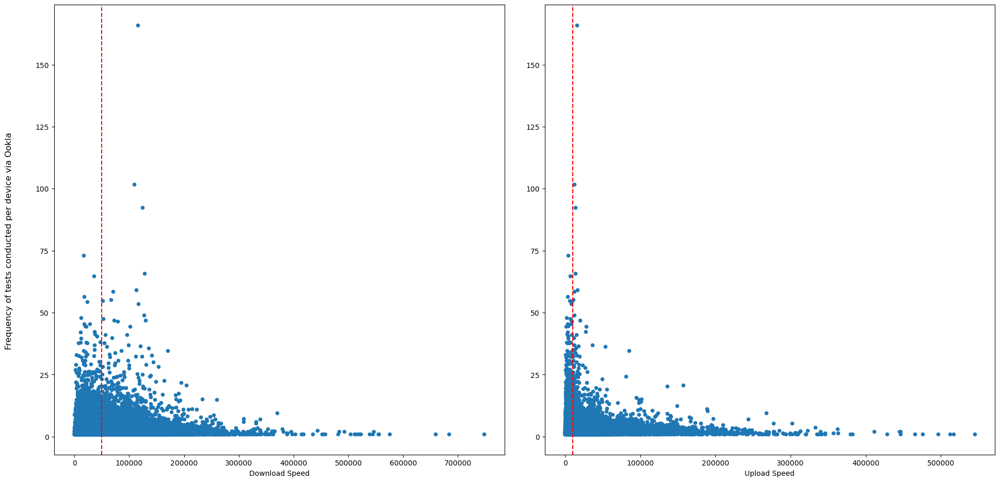

In [17]:
fig, axs = plt.subplots(1, 2, figsize=(20,10))

data.plot.scatter('avg_d_kbps', 'test_frequency', ax=axs[0])
data.plot.scatter('avg_u_kbps', 'test_frequency', ax=axs[1])

axs[0].axvline(50000, color='r', ls='--')
axs[1].axvline(10000, color='r', ls='--')

axs[0].set_xlabel('Download Speed')
axs[1].set_xlabel('Upload Speed')
axs[0].set_ylabel('')
axs[1].set_ylabel('')

fig.supylabel('Frequency of tests conducted per device via Ookla')
#fig.suptitle('Distribution of average internet speeds across ' \
#             'Canada over the last four years',
#             fontsize=25)
fig.tight_layout(pad=3);

#### Correlation maps

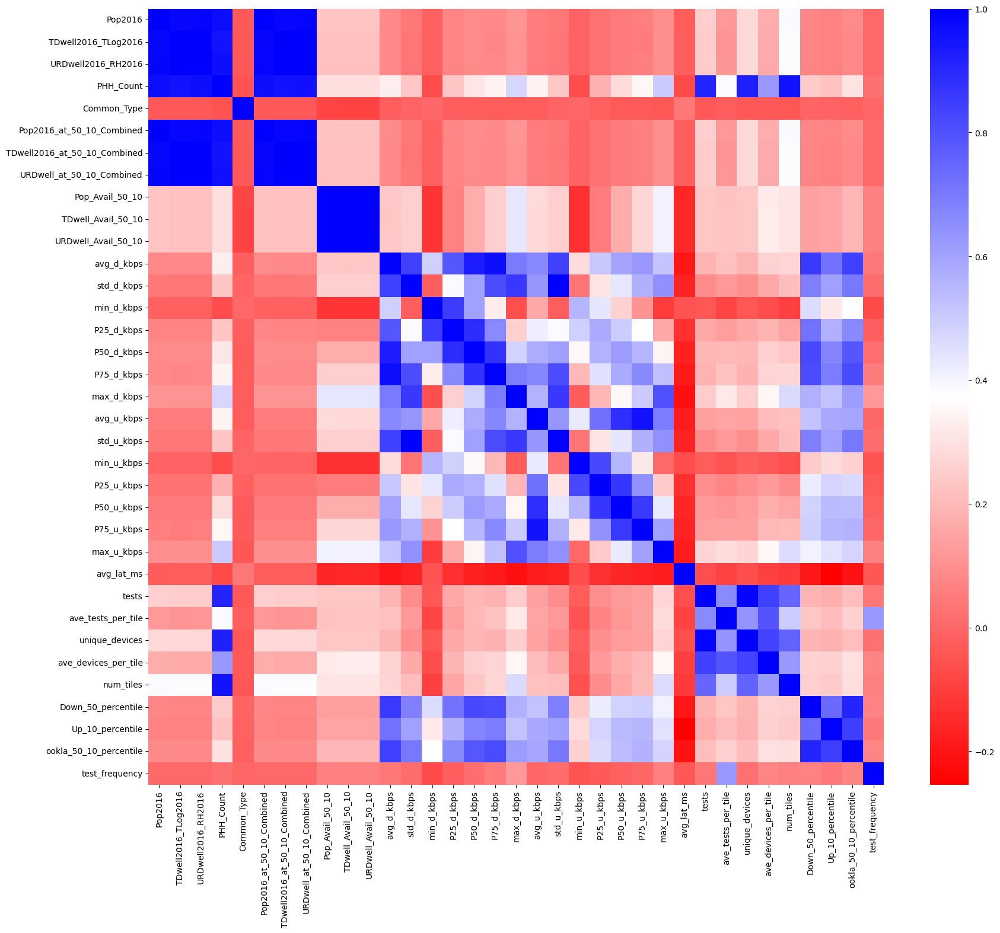

In [18]:
corr = data.corr(numeric_only=True)

# plotting the heatmap
plt.figure(figsize=(20,17))
sns.heatmap(corr, cmap='bwr_r')
plt.show()

In [20]:
# correlation to the average internet speeds
corr2 = corr[['avg_d_kbps', 
              'avg_u_kbps']].drop(['avg_d_kbps', 
                                   'avg_u_kbps'], axis=0).reset_index()
corr2.head()

,index,avg_d_kbps,avg_u_kbps
0,Pop2016,0.083426,0.053618
1,TDwell2016_TLog2016,0.079501,0.051598
2,URDwell2016_RH2016,0.080529,0.052062
3,PHH_Count,0.329656,0.342619
4,Common_Type,-0.022226,-0.026966


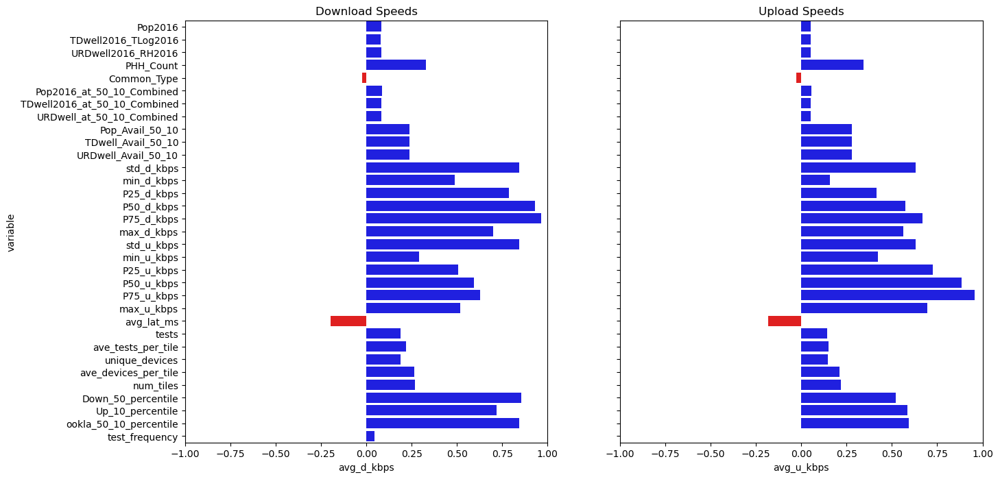

In [21]:
fig, axs = plt.subplots(1, 2, figsize=(15,8))
sns.barplot(data=corr2,x=corr2['avg_d_kbps'],y=corr2['index'],ax=axs[0],
            palette=corr2['avg_d_kbps'].apply(lambda x: 'b' if x>0 else 'r'),
            orient='h')

sns.barplot(data=corr2,x=corr2['avg_u_kbps'],y=corr2['index'],ax=axs[1],
            palette=corr2['avg_u_kbps'].apply(lambda x: 'b' if x>0 else 'r'),
            orient='h')

axs[0].set(xlim=(-1, 1), ylabel='variable', 
           title='Download Speeds')
axs[1].set(xlim=(-1, 1), ylabel=None, 
           yticklabels=[], title='Upload Speeds')

plt.show()

**Summary**
Overall, our EDA reveals high correlation between numberical variables studies and internet speeds. Particulary, `PHH_Count`, `Common_Type`, `Pop_Avail_50_10`, `min_d_kbps`, `max_d_kbps`, `std_d_kbps`, `min_u_kbps`, `max_u_kbps``std_u_kbps`, `connections`, and `test_frequency` are reccommeded features for ML modeling

### Improving the linear model

In [22]:
# categorizing the variables
key = 'HEXUID_PCPUID'
geometry = 'geometry'

id_and_names = ['PCPUID', 'PCUID', 'PCNAME']

categorical_vars = ['PRCODE', 'PCCLASS', 'connections']

numerical_vars = ['PHH_Count', 'Common_Type', 
                  'std_d_kbps', 'min_d_kbps', 
                  'max_d_kbps', 'std_u_kbps', 
                  'min_u_kbps', 'max_u_kbps',  
                  'test_frequency',
                  'Pop_Avail_50_10']

other_vars = ['Pop2016','TDwell2016_TLog2016', 
              'URDwell2016_RH2016',
              'Pop2016_at_50_10_Combined', 
              'TDwell2016_at_50_10_Combined', 
              'URDwell_at_50_10_Combined', 
              'TDwell_Avail_50_10',
              'URDwell_Avail_50_10',
              'P25_d_kbps', 'P50_d_kbps', 'P75_d_kbps',
              'P25_u_kbps', 'P50_u_kbps', 'P75_u_kbps',
              'tests', 'ave_tests_per_tile',
              'unique_devices', 'ave_devices_per_tile', 'num_tiles',
              'Down_50_percentile', 'Up_10_percentile','min_year', 
              'max_year']

target_vars = ['avg_d_kbps', 'avg_u_kbps']

In [46]:
ml_vars = [key] + categorical_vars + numerical_vars + target_vars
ml_data = data.loc[:,ml_vars].set_index('HEXUID_PCPUID')
ml_data.head()

,PRCODE,PCCLASS,connections,PHH_Count,Common_Type,std_d_kbps,min_d_kbps,max_d_kbps,std_u_kbps,min_u_kbps,max_u_kbps,test_frequency,Pop_Avail_50_10,avg_d_kbps,avg_u_kbps
HEXUID_PCPUID,,,,,,,,,,,,,,,
NL47580528-100792,NL,4,fixed,NaN,NaN,93758.541595,161.0,587624.0,93758.541595,62.0,418553.0,2.919125,NaN,158449.144284,85493.039956
NL47580529-100792,NL,4,fixed,NaN,NaN,129507.236557,1398.0,855354.0,129507.236557,48.0,633774.0,3.348339,NaN,189884.916300,101254.361233
NL47430528-100792,NL,4,fixed,NaN,NaN,74691.885068,37021.0,267312.0,74691.885068,15747.0,179309.0,3.282051,NaN,183984.000000,98761.117647
NL47510528-100792,NL,4,fixed,NaN,NaN,96006.770122,54.0,559988.0,96006.770122,93.0,570790.0,3.392346,NaN,169838.995219,88459.522541
NL47510529-100792,NL,4,fixed,NaN,NaN,118972.951803,221.0,668781.0,118972.951803,489.0,698768.0,3.765239,NaN,189661.043774,99826.766537


In [47]:
ml_data.shape

(50331, 15)

In [48]:
ml_data.isna().sum()

PRCODE                 0
PCCLASS            48634
connections            0
PHH_Count          38588
Common_Type        38588
std_d_kbps         11315
min_d_kbps          3232
max_d_kbps          3232
std_u_kbps         11315
min_u_kbps          3232
max_u_kbps          3232
test_frequency      3232
Pop_Avail_50_10    38781
avg_d_kbps          3232
avg_u_kbps          3232
dtype: int64

In [28]:
ml_data = ml_data.dropna()
ml_data.shape

(192, 15)

In [29]:
# create a standard train/test where down and/or up speeds are 
# the target/predicted continuous variable.

X_train, X_test, \
down_train, down_test, \
up_train, up_test = model_selection.train_test_split(
    ml_data, ml_data['avg_d_kbps'], ml_data['avg_u_kbps']
)

In [30]:
# normalize the numerical Data and OneHot encode the categorical vars.
colTransformer = compose.ColumnTransformer(
    [(f"{cat}",preprocessing.OneHotEncoder(),[cat]) for cat in categorical_vars] \
    + [(f"{num}", preprocessing.StandardScaler(), [num]) for num in numerical_vars] 
    + [(f"{y}_stdscaler", preprocessing.StandardScaler(), [y]) for y in target_vars]
)

# setup a regressor for predicting down/up speeds.
regressor = linear_model.RidgeCV()

# combine above in a reuseable pipeline object
pipe = pipeline.Pipeline([
    ('preprocess',colTransformer),
    ('regressor', regressor)
])

In [39]:
#train the downloads model
pipe.fit(X_train, down_train)

Pipeline(steps=[('preprocess',
                 ColumnTransformer(transformers=[('PRCODE', OneHotEncoder(),
                                                  ['PRCODE']),
                                                 ('PCCLASS', OneHotEncoder(),
                                                  ['PCCLASS']),
                                                 ('connections',
                                                  OneHotEncoder(),
                                                  ['connections']),
                                                 ('PHH_Count', StandardScaler(),
                                                  ['PHH_Count']),
                                                 ('Common_Type',
                                                  StandardScaler(),
                                                  ['Common_Type']),
                                                 ('std_d_kbps',
                                                  StandardScaler(),
                                                  ['std_d_kbps']),
                                                 ('min_d_kbps',
                                                  Standar...
                                                  ['std_u_kbps']),
                                                 ('min_u_kbps',
                                                  StandardScaler(),
                                                  ['min_u_kbps']),
                                                 ('max_u_kbps',
                                                  StandardScaler(),
                                                  ['max_u_kbps']),
                                                 ('test_frequency',
                                                  StandardScaler(),
                                                  ['test_frequency']),
                                                 ('Pop_Avail_50_10',
                                                  StandardScaler(),
                                                  ['Pop_Avail_50_10']),
                                                 ('avg_d_kbps_stdscaler',
                                                  StandardScaler(),
                                                  ['avg_d_kbps']),
                                                 ('avg_u_kbps_stdscaler',
                                                  StandardScaler(),
                                                  ['avg_u_kbps'])])),
                ('regressor', RidgeCV())])

In [40]:
# how did it do on the training set
# speeds are in kbps
{"Mean Absolute Error":metrics.mean_absolute_error(pipe.predict(X_train), down_train),
"Median Absolute Error":metrics.median_absolute_error(pipe.predict(X_train), down_train),
"Mean Absolute Percentage Error":metrics.mean_absolute_percentage_error(pipe.predict(X_train), down_train)
}

{'Mean Absolute Error': 65.1478787174535,
 'Median Absolute Error': 55.174163665058586,
 'Mean Absolute Percentage Error': 0.0006432841906105329}

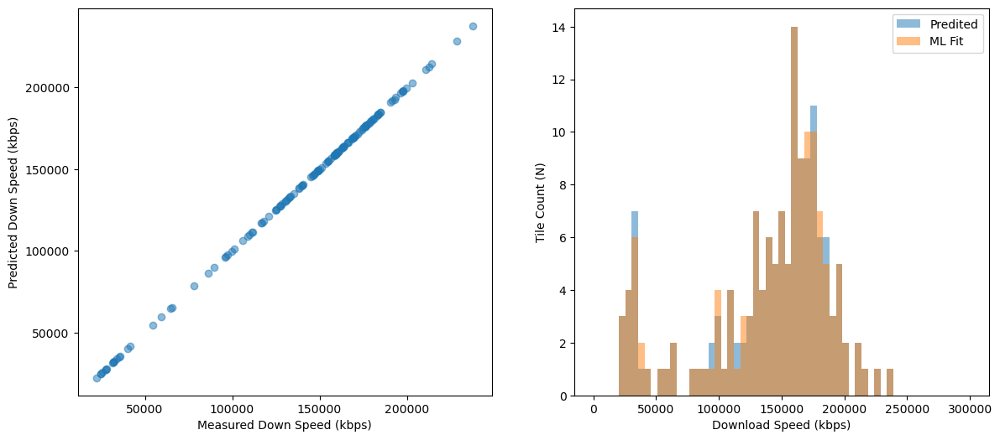

In [41]:
fig, axs = plt.subplots(1,2, figsize=(14,6))
axs[0].scatter(down_train, pipe.predict(X_train), alpha=0.5);
axs[0].set(xlabel="Measured Down Speed (kbps)", ylabel="Predicted Down Speed (kbps)");

bins = np.linspace(0,300000,60)
axs[1].hist(down_train,alpha=0.5, bins=bins,label='Predited')
axs[1].hist(pipe.predict(X_train),alpha=0.5, bins=bins,label='ML Fit');
axs[1].legend()
axs[1].set(xlabel='Download Speed (kbps)', ylabel='Tile Count (N)');

In [42]:
#train the downloads model
pipe.fit(X_train, up_train)

Pipeline(steps=[('preprocess',
                 ColumnTransformer(transformers=[('PRCODE', OneHotEncoder(),
                                                  ['PRCODE']),
                                                 ('PCCLASS', OneHotEncoder(),
                                                  ['PCCLASS']),
                                                 ('connections',
                                                  OneHotEncoder(),
                                                  ['connections']),
                                                 ('PHH_Count', StandardScaler(),
                                                  ['PHH_Count']),
                                                 ('Common_Type',
                                                  StandardScaler(),
                                                  ['Common_Type']),
                                                 ('std_d_kbps',
                                                  StandardScaler(),
                                                  ['std_d_kbps']),
                                                 ('min_d_kbps',
                                                  Standar...
                                                  ['std_u_kbps']),
                                                 ('min_u_kbps',
                                                  StandardScaler(),
                                                  ['min_u_kbps']),
                                                 ('max_u_kbps',
                                                  StandardScaler(),
                                                  ['max_u_kbps']),
                                                 ('test_frequency',
                                                  StandardScaler(),
                                                  ['test_frequency']),
                                                 ('Pop_Avail_50_10',
                                                  StandardScaler(),
                                                  ['Pop_Avail_50_10']),
                                                 ('avg_d_kbps_stdscaler',
                                                  StandardScaler(),
                                                  ['avg_d_kbps']),
                                                 ('avg_u_kbps_stdscaler',
                                                  StandardScaler(),
                                                  ['avg_u_kbps'])])),
                ('regressor', RidgeCV())])

In [43]:
# how did it do on the training set
# speeds are in kbps
{"Mean Absolute Error":metrics.mean_absolute_error(pipe.predict(X_train), up_train),
"Median Absolute Error":metrics.median_absolute_error(pipe.predict(X_train), up_train),
"Mean Absolute Percentage Error":metrics.mean_absolute_percentage_error(pipe.predict(X_train), up_train)
}

{'Mean Absolute Error': 25.69981828796315,
 'Median Absolute Error': 21.657968440624245,
 'Mean Absolute Percentage Error': 0.0006490143073019108}

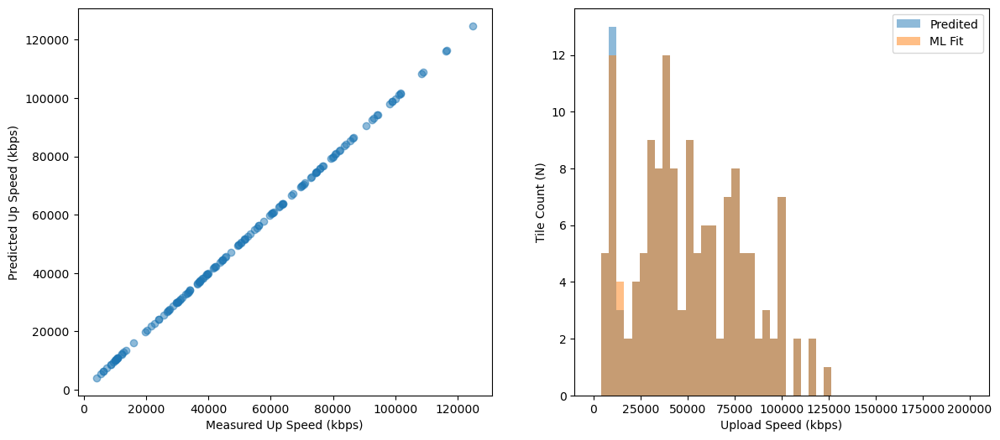

In [44]:
fig, axs = plt.subplots(1,2, figsize=(14,6))
axs[0].scatter(up_train, pipe.predict(X_train), alpha=0.5);
axs[0].set(xlabel="Measured Up Speed (kbps)", ylabel="Predicted Up Speed (kbps)");

bins = np.linspace(0,200000,50)
axs[1].hist(up_train,alpha=0.5, bins=bins,label='Predited')
axs[1].hist(pipe.predict(X_train),alpha=0.5, bins=bins,label='ML Fit');
axs[1].legend()
axs[1].set(xlabel='Upload Speed (kbps)', ylabel='Tile Count (N)');